# 1. Install and import libraries

In [1]:
!pip install numba==0.61.0 torchaudio==2.6.0 librosa==0.10.2.post1 timm -q

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.8/3.8 MB 19.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 260.1/260.1 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 50.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 32.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 26.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 15.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 79.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4

In [2]:
import os
import torch
import torch.nn as nn
import torch.optim as optim
import torchaudio
import torchaudio.transforms as T
import numpy as np
import librosa
import librosa.display
import IPython.display as ipd
import torch.nn.functional as F
import matplotlib.pyplot as plt
import json
import timm

from sklearn.preprocessing import MinMaxScaler
from torch.utils.data import Dataset, DataLoader
from IPython.display import Audio
from tqdm import tqdm

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# 2. Download audio dataset

In [3]:
!gdown 1u2WzsWUlyZbbPDfXAWXuLRMTwFkT21wa
!unzip -q crawled_piano_audio_40_pages.zip -d piano_audio_files_40_pages
#os.remove("crawled_piano_audio_40_pages.zip")

Downloading...
From (original): https://drive.google.com/uc?id=1u2WzsWUlyZbbPDfXAWXuLRMTwFkT21wa
From (redirected): https://drive.google.com/uc?id=1u2WzsWUlyZbbPDfXAWXuLRMTwFkT21wa&confirm=t&uuid=1db707ea-d8b1-47f2-8311-dda4d06d292a
To: /content/crawled_piano_audio_40_pages.zip
100% 4.35G/4.35G [01:02<00:00, 70.1MB/s]


# 3. Define audio data processing functions

In [ ]:
def load_and_get_genres(json_path):
    with open(json_path, "r") as f:
        data = json.load(f)

    return data.get('genres', [])

json_dir = os.path.join("piano_audio_files", "crawled_data")

In [ ]:
def load_and_resample_audio(file_path, target_sr=22050):
    audio, sr = librosa.load(file_path, sr=None)
    if sr != target_sr:
        audio = librosa.resample(audio, orig_sr=sr, target_sr=target_sr)

    return audio, target_sr

def audio_to_melspec(audio, sr, n_mels, n_fft=2048, hop_length=512, to_db=False):
    spec = librosa.feature.melspectrogram(y=audio,
                                          sr=sr,
                                          n_fft=n_fft,
                                          hop_length=hop_length,
                                          win_length=None,
                                          window="hann",
                                          center=True,
                                          pad_mode="reflect",
                                          power=2.0,
                                          n_mels=n_mels)

    if to_db:
        spec = librosa.power_to_db(spec, ref=np.max)

    return spec

def normalize_melspec(melspec, norm_range=(0, 1)):
    scaler = MinMaxScaler(feature_range=norm_range)
    melspec = melspec.T
    melspec_normalized = scaler.fit_transform(melspec)

    return melspec_normalized.T


def denormalize_melspec(melspec_normalized, original_melspec, norm_range=(0, 1)):
    scaler = MinMaxScaler(feature_range=norm_range)
    melspec = original_melspec.T
    scaler.fit(melspec)
    melspec_denormalized = scaler.inverse_transform(melspec_normalized.T)

    return melspec_denormalized.T


def melspec_to_audio(melspec, sr, n_fft=2048, hop_length=512, n_iter=64):
    if np.any(melspec < 0):
        melspec = librosa.db_to_power(melspec)

    audio_reconstructed = librosa.feature.inverse.mel_to_audio(melspec,
                                                              sr=sr,
                                                              n_fft=n_fft,
                                                              hop_length=hop_length,
                                                              win_length=None,
                                                              window="hann",
                                                              center=True,
                                                              pad_mode="reflect",
                                                              power=2.0,
                                                              n_iter=n_iter)
    return audio_reconstructed

def display_audio_files(reconstructed_audio, sr, title="", original_audio=None):
    if original_audio is not None:
        print("Original Audio:")
        ipd.display(ipd.Audio(original_audio, rate=sr))
        print("Reconstructed Audio (from Mel Spectrogram):")
    else:
        print(title)

    ipd.display(ipd.Audio(reconstructed_audio, rate=sr))

def show_spectrogram(spectrogram, title="Mel-Spectrogram", denormalize=False, is_numpy=False):
    if not is_numpy:
        spectrogram = spectrogram.squeeze().cpu().numpy()
    plt.figure(figsize=(10, 4))
    if denormalize:
        plt.imshow(spectrogram, aspect="auto", origin="lower", cmap="viridis")
    else:
        plt.imshow(spectrogram, aspect="auto", origin="lower", cmap="viridis", vmin=0, vmax=1)
    plt.title(title)
    plt.xlabel("Time")
    plt.ylabel("Mel Frequency")
    plt.colorbar()
    plt.show()

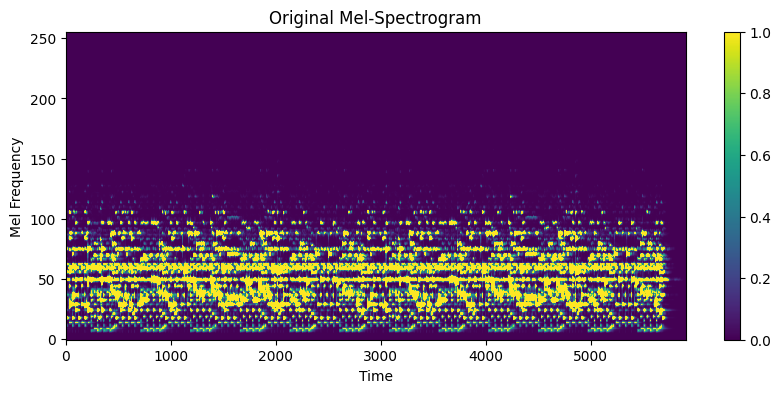

In [ ]:
audio, target_sr = load_and_resample_audio(os.path.join("piano_audio_files", "crawled_data", "audio", "audio_0001.mp3"))

mel_spectrogram = audio_to_melspec(audio, target_sr, n_mels=256)

show_spectrogram(mel_spectrogram, title="Original Mel-Spectrogram", is_numpy=True)

In [ ]:
json_dir = os.path.join("piano_audio_files", "crawled_data")
all_genres = []

for filename in os.listdir(json_dir):
    if filename.endswith('.json'):
        json_path = os.path.join(json_dir, filename)
        genres = load_and_get_genres(json_path)
        all_genres.extend(genres)

unique_genres = set(all_genres)
max_genres = len(unique_genres)
print(f"Total unique genres: {max_genres}")
print(f"Unique genres: {unique_genres}")

In [ ]:
genres2idx = {genre: idx for idx, genre in enumerate(unique_genres)}
idx2genres = {idx: genre for genre, idx in genres2idx.items()}

def tokenize(genres):
    return [genres2idx[genre] for genre in genres if genre in genres2idx]

def detokenize_tolist(tokens):
    return [idx2genres[token] for token in tokens if token in idx2genres]

def onehot_encode(tokens, max_genres):
    onehot = np.zeros(max_genres)
    onehot[tokens] = 1
    return onehot

def onehot_decode(onehot):
    return [idx for idx, val in enumerate(onehot) if val == 1]

# 4. Create PyTorch DataLoader

In [ ]:
class AudioDataset(Dataset):
    def __init__(self, data_dir, json_dir, sample_rate, duration, n_mels, n_genres, testset_amount=10):
        self.data_dir = data_dir
        self.files = [os.path.join(data_dir, f) for f in os.listdir(data_dir) if f.endswith(".mp3")]
        self.json_dir = json_dir
        self.json_files = [os.path.join(json_dir, f) for f in os.listdir(json_dir) if f.endswith(".json")]
        self.sample_rate = sample_rate
        self.duration = duration
        self.fixed_length = sample_rate * duration
        self.n_genres = n_genres
        self.n_mels = n_mels

        audios = []
        for file_path, json_file_path in tqdm(zip(self.files, self.json_files), desc=f"Loading audio files in {data_dir}", unit="file", total=len(self.files)):
            audio, sr = load_and_resample_audio(file_path, target_sr=sample_rate)
            genres_list = load_and_get_genres(json_file_path)

            genres_tokens = tokenize(genres_list)
            genres_input = onehot_encode(genres_tokens, n_genres)
            genres_input = torch.tensor(genres_input, dtype=torch.long).unsqueeze(0)

            n_samples = len(audio)
            n_segments = n_samples // self.fixed_length

            for i in range(n_segments):
                start = i * self.fixed_length
                end = (i + 1) * self.fixed_length
                segment = audio[start:end]
                mel_spec = audio_to_melspec(segment, sr, self.n_mels, to_db=True)
                mel_spec_norm = normalize_melspec(mel_spec)
                mel_spec = torch.tensor(mel_spec, dtype=torch.float32).unsqueeze(0)
                mel_spec_norm = torch.tensor(mel_spec_norm, dtype=torch.float32).unsqueeze(0)
                audios.append((mel_spec_norm, genres_input, mel_spec))

        self.audios = audios[:len(audios) - testset_amount]
        self.testset = audios[len(audios) - testset_amount:]
        print(f"Loaded {len(self.audios)} audio segments from {len(self.files)} files, each with shape: {self.audios[0][0].shape}, {self.audios[0][1].shape}, duration: {duration} seconds")
        print(f"Test set: {len(self.testset)} audio segments")


    def __len__(self):
        return len(self.audios)

    def __getitem__(self, idx):
        mel_spec_part, genres_input, mel_spec = self.audios[idx]
        return mel_spec_part, genres_input, mel_spec

In [ ]:
sample_rate = 22050
duration = 3
n_mels = 256

audio_dir = os.path.join("piano_audio_files", "crawled_data", "audio")
json_dir = os.path.join("piano_audio_files", "crawled_data")

testset_amount = 32
trainset = AudioDataset(audio_dir, json_dir, sample_rate, duration,
                        n_mels, max_genres, testset_amount=testset_amount)
testset = trainset.testset

if len(trainset) == 0:
    raise ValueError(f"No .wav file found in {audio_dir}.")

trainloader = DataLoader(trainset, batch_size=128, shuffle=True, num_workers=4)
testloader = DataLoader(testset, batch_size=testset_amount, shuffle=False, num_workers=4)

tensor([[0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 1, 0,
         0]])
130


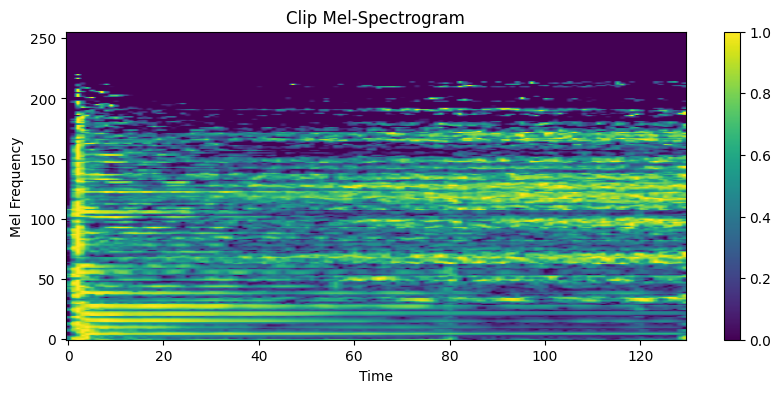

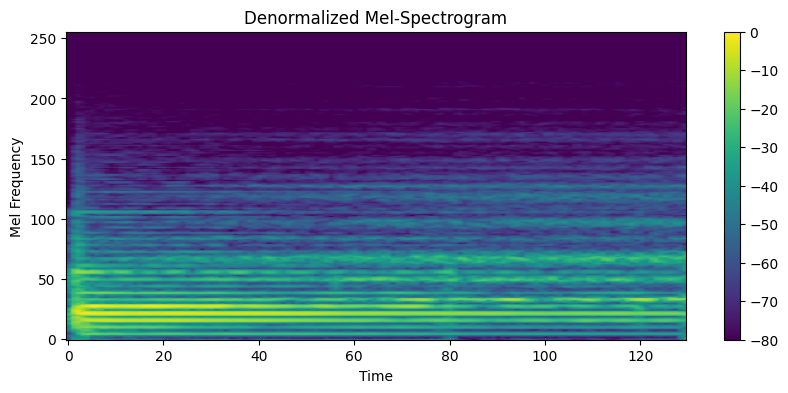

Original Audio after convert to Spectrogram and back to Audio


In [ ]:
audios = trainloader.dataset.audios.copy()

frame = audios[0][0].shape[-1]
print(audios[0][1])
print(frame)

for i in range(1):
    show_spectrogram(audios[i][0], title="Clip Mel-Spectrogram")
    spec_denorm = denormalize_melspec(audios[i][0].numpy().squeeze(), audios[i][2].numpy().squeeze())
    show_spectrogram(torch.tensor(spec_denorm), title="Denormalized Mel-Spectrogram", denormalize=True)
    audio_reconstructed = melspec_to_audio(spec_denorm, sample_rate)
    display_audio_files(audio_reconstructed, sample_rate, title="Original Audio after convert to Spectrogram and back to Audio")

# 5. Create VAE model

In [ ]:
class CVAE(nn.Module):
    def __init__(self, d_model, latent_dim, n_frames, n_mels, n_genres):
        super(CVAE, self).__init__()
        self.d_model = d_model
        self.latent_dim = latent_dim
        self.n_frames = int(np.ceil(n_frames / 2**3))
        self.n_mels = int(np.ceil(n_mels / 2**3))
        self.n_genres = n_genres
        print(self.n_frames, self.n_mels)

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(1 + self.n_genres, d_model, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(d_model),
            nn.SiLU(),
            nn.Dropout2d(0.05),

            nn.Conv2d(d_model, d_model * 2, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(d_model * 2),
            nn.SiLU(),
            nn.Dropout2d(0.1),

            nn.Conv2d(d_model * 2, d_model * 4, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(d_model * 4),
            nn.SiLU(),
            nn.Dropout2d(0.15),

            nn.AdaptiveAvgPool2d((1, 1)),  # [B, 4*d, 1, 1]
            nn.Flatten()
        )

        # Latent space
        self.fc_mu = nn.Linear(d_model * 4, latent_dim)
        self.fc_logvar = nn.Linear(d_model * 4, latent_dim)

        # Decoder
        self.decoder_input = nn.Linear(latent_dim + self.n_genres, d_model * 4 * self.n_frames * self.n_mels)
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(d_model * 4, d_model * 2, kernel_size=3, stride=2, padding=1, output_padding=(1, 0)),
            nn.BatchNorm2d(d_model * 2),
            nn.SiLU(),
            nn.Dropout2d(0.1),

            nn.ConvTranspose2d(d_model * 2, d_model, kernel_size=3, stride=2, padding=1, output_padding=(1, 0)),
            nn.BatchNorm2d(d_model),
            nn.SiLU(),
            nn.Dropout2d(0.05),

            nn.ConvTranspose2d(d_model, 1, kernel_size=3, stride=2, padding=1, output_padding=1),  # [B, 1, n_mels, n_frame]
            nn.Sigmoid()
        )

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x, genres_input):
        ori_genres_embed = genres_input.view(genres_input.size(0), -1)
        genres_embed = ori_genres_embed.unsqueeze(-1).unsqueeze(-1)
        genres_embed = genres_embed.expand(-1, -1, x.size(2), x.size(3))
        x_genres = torch.cat((x, genres_embed), dim=1)

        h = x_genres
        shortcuts = []
        for block in self.encoder:
            h = block(h)
            if isinstance(block, nn.SiLU):
                shortcuts.append(h)

        mu = self.fc_mu(h)
        logvar = self.fc_logvar(h)

        z = self.reparameterize(mu, logvar)
        z_genres = torch.cat((z, ori_genres_embed), dim=1)

        h_dec = self.decoder_input(z_genres)
        h_dec = h_dec.view(-1, self.d_model * 4, self.n_frames, self.n_mels)

        for block in self.decoder:
            if isinstance(block, nn.ConvTranspose2d) and shortcuts:
                shortcut = shortcuts.pop()
                h_dec = h_dec + shortcut
            h_dec = block(h_dec)

        recon = h_dec[:, :, :x.size(2), :x.size(3)]
        return recon, mu, logvar

# 6. Training

In [ ]:
def loss_function(recon_x, x, mu, logvar):
    recon_loss = nn.functional.mse_loss(recon_x, x, reduction="sum")
    KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
    return recon_loss + KLD

In [ ]:
def train_vae(model, dataloader, optimizer, scheduler, num_epochs, verbose_interval=50):
    model.train()
    losses = []
    for epoch in tqdm(range(num_epochs), desc="Training", unit="epoch"):
        train_loss = 0
        for batch_idx, (data, genres_input, ori_data) in enumerate(dataloader):
            data = data.to(device)
            genres_input = genres_input.to(device)

            optimizer.zero_grad()

            recon, mu, logvar = model(data, genres_input)
            loss = loss_function(recon, data, mu, logvar)
            loss.backward()
            train_loss += loss.item()
            optimizer.step()

        scheduler.step()
        avg_loss = train_loss / len(dataloader.dataset)
        losses.append(avg_loss)
        print(f"Epoch {epoch}/{num_epochs}, Loss: {avg_loss:.4f}, Lr: {scheduler.get_last_lr()[0]}")
        if epoch == 0 or (epoch + 1) % verbose_interval == 0:
            data = data[0].detach().cpu()
            recon_img = recon[0].detach().cpu()
            show_spectrogram(data, title="Original Spectrogram")
            show_spectrogram(recon_img, title="Reconstructed Spectrogram")
    return mu, logvar, losses

32 17
Total number of parameters: 22267201


Training:   0%|          | 0/100 [00:00<?, ?epoch/s]

Epoch 0/100, Loss: 1254.9754, Lr: 0.0002


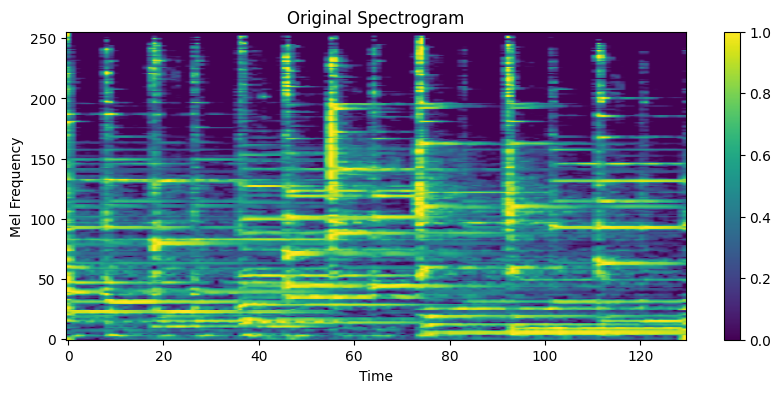

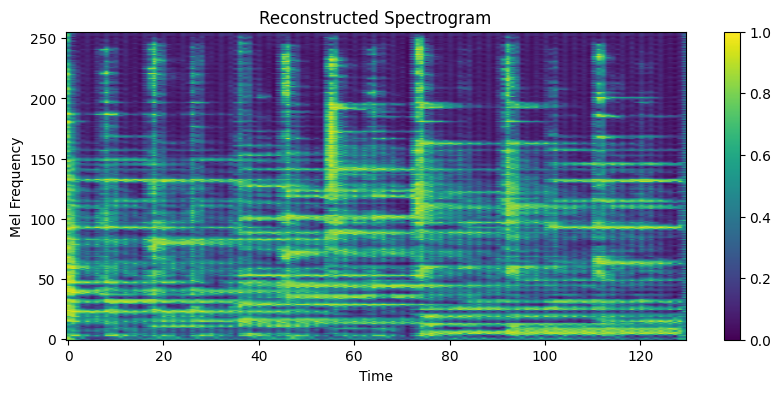

Training:   2%|▏         | 2/100 [00:18<15:13,  9.32s/epoch]

Epoch 1/100, Loss: 318.4383, Lr: 0.0002


Training:   3%|▎         | 3/100 [00:27<14:40,  9.08s/epoch]

Epoch 2/100, Loss: 197.9182, Lr: 0.0002


Training:   4%|▍         | 4/100 [00:36<14:21,  8.98s/epoch]

Epoch 3/100, Loss: 143.5669, Lr: 0.0002


Training:   5%|▌         | 5/100 [00:45<14:05,  8.89s/epoch]

Epoch 4/100, Loss: 111.8819, Lr: 0.0002


Training:   6%|▌         | 6/100 [00:54<13:54,  8.88s/epoch]

Epoch 5/100, Loss: 91.5805, Lr: 0.0002


Training:   7%|▋         | 7/100 [01:02<13:46,  8.89s/epoch]

Epoch 6/100, Loss: 80.0140, Lr: 0.0002


Training:   8%|▊         | 8/100 [01:12<13:42,  8.94s/epoch]

Epoch 7/100, Loss: 69.9488, Lr: 0.0002


Training:   9%|▉         | 9/100 [01:21<13:41,  9.02s/epoch]

Epoch 8/100, Loss: 62.3425, Lr: 0.0002
Epoch 9/100, Loss: 57.4847, Lr: 0.0002


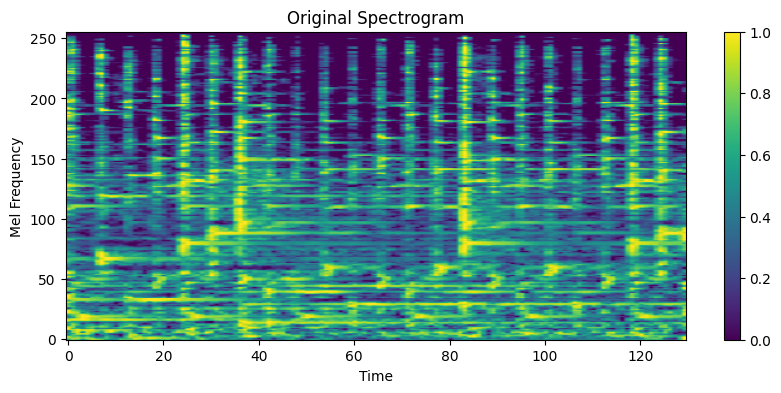

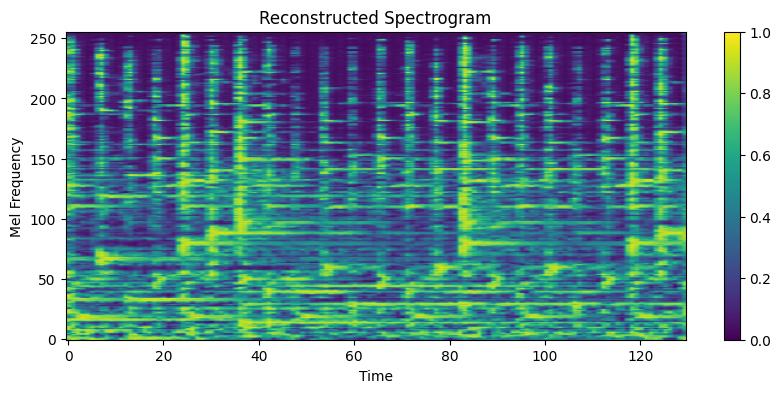

Training:  11%|█         | 11/100 [01:39<13:33,  9.14s/epoch]

Epoch 10/100, Loss: 53.1061, Lr: 0.0002


Training:  12%|█▏        | 12/100 [01:49<13:28,  9.19s/epoch]

Epoch 11/100, Loss: 48.9794, Lr: 0.0002


Training:  13%|█▎        | 13/100 [01:58<13:20,  9.20s/epoch]

Epoch 12/100, Loss: 46.5934, Lr: 0.0002


Training:  14%|█▍        | 14/100 [02:07<13:14,  9.24s/epoch]

Epoch 13/100, Loss: 43.7846, Lr: 0.0002


Training:  15%|█▌        | 15/100 [02:16<13:00,  9.19s/epoch]

Epoch 14/100, Loss: 40.9684, Lr: 0.0002


Training:  16%|█▌        | 16/100 [02:25<12:51,  9.18s/epoch]

Epoch 15/100, Loss: 39.5519, Lr: 0.0002


Training:  17%|█▋        | 17/100 [02:34<12:39,  9.15s/epoch]

Epoch 16/100, Loss: 37.6223, Lr: 0.0002


Training:  18%|█▊        | 18/100 [02:43<12:24,  9.08s/epoch]

Epoch 17/100, Loss: 36.7424, Lr: 0.0002


Training:  19%|█▉        | 19/100 [02:53<12:18,  9.11s/epoch]

Epoch 18/100, Loss: 35.2556, Lr: 0.0002
Epoch 19/100, Loss: 33.6699, Lr: 0.0002


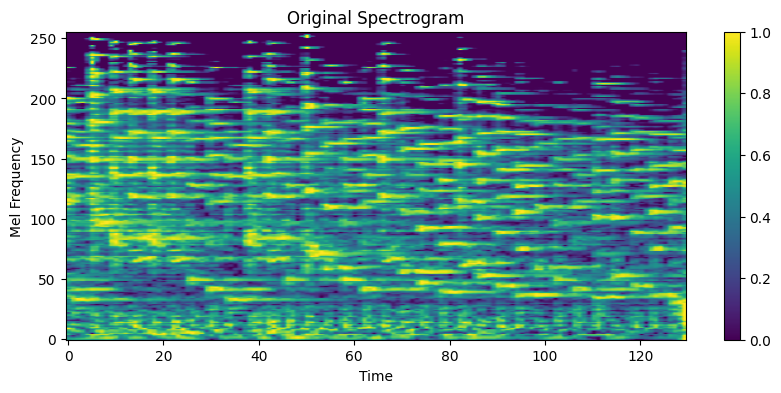

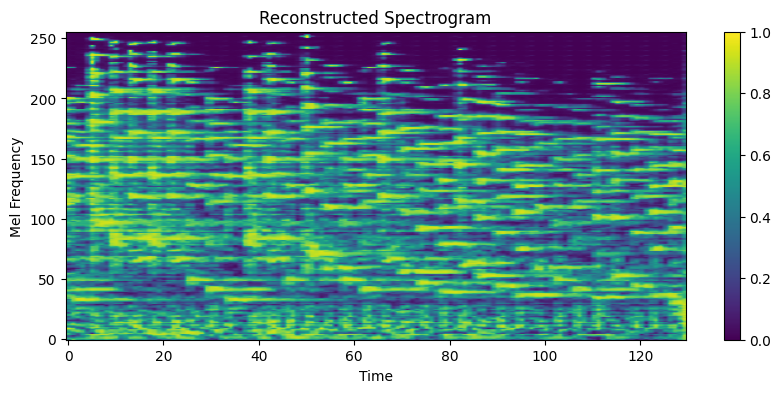

Training:  21%|██        | 21/100 [03:11<12:06,  9.19s/epoch]

Epoch 20/100, Loss: 33.0123, Lr: 0.0002


Training:  22%|██▏       | 22/100 [03:20<11:53,  9.15s/epoch]

Epoch 21/100, Loss: 32.3293, Lr: 0.0002


Training:  23%|██▎       | 23/100 [03:29<11:42,  9.13s/epoch]

Epoch 22/100, Loss: 30.7791, Lr: 0.0002


Training:  24%|██▍       | 24/100 [03:38<11:33,  9.12s/epoch]

Epoch 23/100, Loss: 29.1017, Lr: 0.0002


Training:  25%|██▌       | 25/100 [03:47<11:18,  9.05s/epoch]

Epoch 24/100, Loss: 28.6979, Lr: 0.0002


Training:  26%|██▌       | 26/100 [03:56<11:12,  9.09s/epoch]

Epoch 25/100, Loss: 28.8259, Lr: 0.0002


Training:  27%|██▋       | 27/100 [04:06<11:05,  9.11s/epoch]

Epoch 26/100, Loss: 28.1026, Lr: 0.0002


Training:  28%|██▊       | 28/100 [04:15<10:57,  9.14s/epoch]

Epoch 27/100, Loss: 26.4654, Lr: 0.0002


Training:  29%|██▉       | 29/100 [04:24<10:51,  9.17s/epoch]

Epoch 28/100, Loss: 25.8038, Lr: 0.0002
Epoch 29/100, Loss: 25.6672, Lr: 0.0002


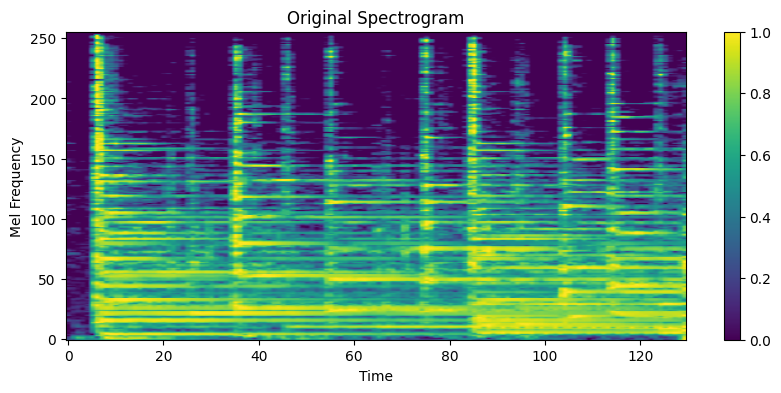

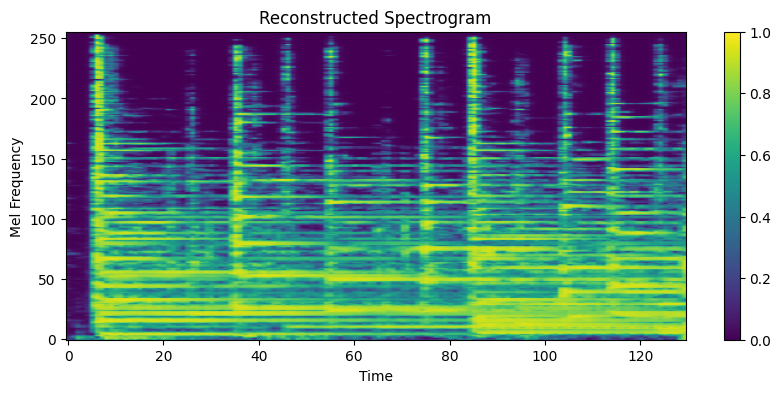

Training:  31%|███       | 31/100 [04:43<10:39,  9.27s/epoch]

Epoch 30/100, Loss: 25.3868, Lr: 0.0002


Training:  32%|███▏      | 32/100 [04:52<10:25,  9.19s/epoch]

Epoch 31/100, Loss: 24.5281, Lr: 0.0002


Training:  33%|███▎      | 33/100 [05:01<10:11,  9.13s/epoch]

Epoch 32/100, Loss: 24.0204, Lr: 0.0002


Training:  34%|███▍      | 34/100 [05:10<10:05,  9.17s/epoch]

Epoch 33/100, Loss: 23.1619, Lr: 0.0002


Training:  35%|███▌      | 35/100 [05:19<09:50,  9.09s/epoch]

Epoch 34/100, Loss: 23.3661, Lr: 0.0002


Training:  36%|███▌      | 36/100 [05:28<09:42,  9.11s/epoch]

Epoch 35/100, Loss: 22.2170, Lr: 0.0002


Training:  37%|███▋      | 37/100 [05:37<09:32,  9.08s/epoch]

Epoch 36/100, Loss: 21.6516, Lr: 0.0002


Training:  38%|███▊      | 38/100 [05:46<09:24,  9.11s/epoch]

Epoch 37/100, Loss: 21.5492, Lr: 0.0002


Training:  39%|███▉      | 39/100 [05:55<09:14,  9.09s/epoch]

Epoch 38/100, Loss: 21.3854, Lr: 0.0002
Epoch 39/100, Loss: 20.8091, Lr: 0.0002


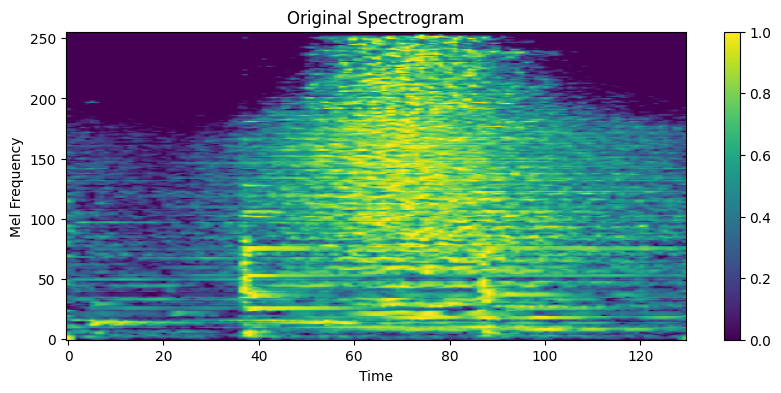

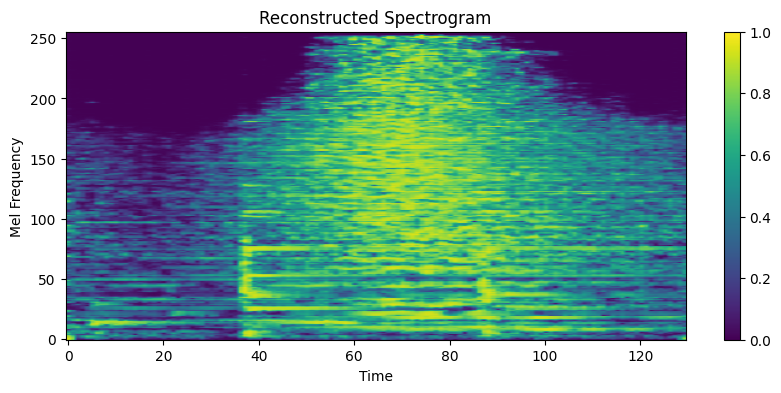

Training:  41%|████      | 41/100 [06:14<09:04,  9.23s/epoch]

Epoch 40/100, Loss: 20.8752, Lr: 0.0002


Training:  42%|████▏     | 42/100 [06:24<08:53,  9.19s/epoch]

Epoch 41/100, Loss: 20.3339, Lr: 0.0002


Training:  43%|████▎     | 43/100 [06:33<08:44,  9.21s/epoch]

Epoch 42/100, Loss: 19.7327, Lr: 0.0002


Training:  44%|████▍     | 44/100 [06:42<08:31,  9.14s/epoch]

Epoch 43/100, Loss: 20.3086, Lr: 0.0002


Training:  45%|████▌     | 45/100 [06:51<08:19,  9.08s/epoch]

Epoch 44/100, Loss: 19.1102, Lr: 0.0002


Training:  46%|████▌     | 46/100 [07:00<08:09,  9.06s/epoch]

Epoch 45/100, Loss: 18.4808, Lr: 0.0002


Training:  47%|████▋     | 47/100 [07:09<07:59,  9.04s/epoch]

Epoch 46/100, Loss: 18.8876, Lr: 0.0002


Training:  48%|████▊     | 48/100 [07:18<07:52,  9.08s/epoch]

Epoch 47/100, Loss: 18.2733, Lr: 0.0002


Training:  49%|████▉     | 49/100 [07:27<07:43,  9.08s/epoch]

Epoch 48/100, Loss: 18.0947, Lr: 0.0002
Epoch 49/100, Loss: 17.2042, Lr: 0.0001


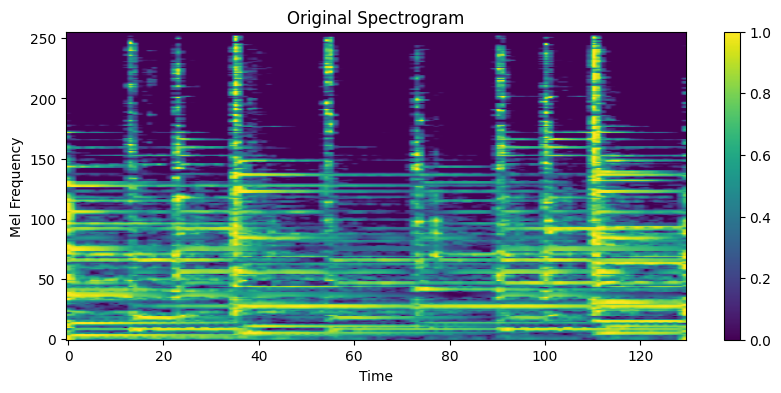

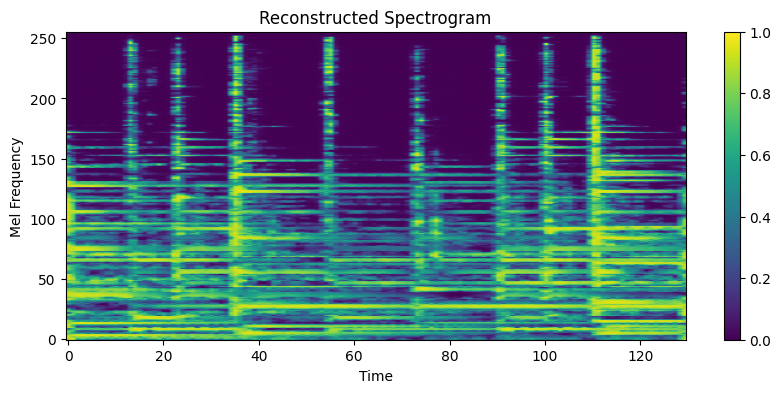

Training:  51%|█████     | 51/100 [07:45<07:27,  9.13s/epoch]

Epoch 50/100, Loss: 16.3050, Lr: 0.0001


Training:  52%|█████▏    | 52/100 [07:54<07:16,  9.09s/epoch]

Epoch 51/100, Loss: 16.9329, Lr: 0.0001


Training:  53%|█████▎    | 53/100 [08:03<07:06,  9.07s/epoch]

Epoch 52/100, Loss: 16.3433, Lr: 0.0001


Training:  54%|█████▍    | 54/100 [08:12<06:56,  9.04s/epoch]

Epoch 53/100, Loss: 15.9929, Lr: 0.0001


Training:  55%|█████▌    | 55/100 [08:22<06:49,  9.09s/epoch]

Epoch 54/100, Loss: 15.9125, Lr: 0.0001


Training:  56%|█████▌    | 56/100 [08:31<06:38,  9.06s/epoch]

Epoch 55/100, Loss: 15.8263, Lr: 0.0001


Training:  57%|█████▋    | 57/100 [08:40<06:29,  9.06s/epoch]

Epoch 56/100, Loss: 15.8647, Lr: 0.0001


Training:  58%|█████▊    | 58/100 [08:49<06:20,  9.05s/epoch]

Epoch 57/100, Loss: 15.6244, Lr: 0.0001


Training:  59%|█████▉    | 59/100 [08:58<06:12,  9.09s/epoch]

Epoch 58/100, Loss: 15.0310, Lr: 0.0001
Epoch 59/100, Loss: 14.9806, Lr: 0.0001


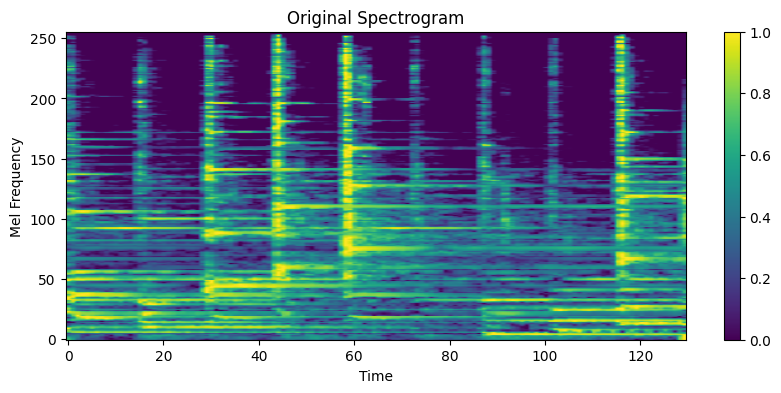

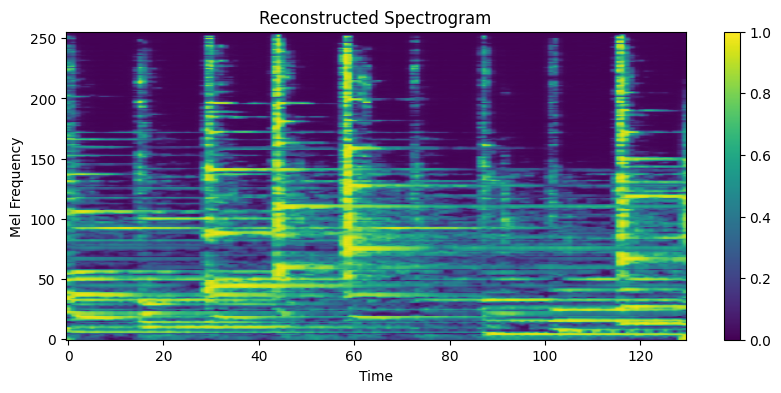

Training:  61%|██████    | 61/100 [09:16<05:55,  9.11s/epoch]

Epoch 60/100, Loss: 15.1963, Lr: 0.0001


Training:  62%|██████▏   | 62/100 [09:25<05:43,  9.05s/epoch]

Epoch 61/100, Loss: 14.6979, Lr: 0.0001


Training:  63%|██████▎   | 63/100 [09:34<05:35,  9.08s/epoch]

Epoch 62/100, Loss: 14.8512, Lr: 0.0001


Training:  64%|██████▍   | 64/100 [09:43<05:27,  9.09s/epoch]

Epoch 63/100, Loss: 14.7955, Lr: 0.0001


Training:  65%|██████▌   | 65/100 [09:53<05:18,  9.09s/epoch]

Epoch 64/100, Loss: 14.8005, Lr: 0.0001


Training:  66%|██████▌   | 66/100 [10:01<05:06,  9.02s/epoch]

Epoch 65/100, Loss: 14.4084, Lr: 0.0001


Training:  67%|██████▋   | 67/100 [10:10<04:56,  9.00s/epoch]

Epoch 66/100, Loss: 14.2015, Lr: 0.0001


Training:  68%|██████▊   | 68/100 [10:19<04:48,  9.01s/epoch]

Epoch 67/100, Loss: 14.4210, Lr: 0.0001


Training:  69%|██████▉   | 69/100 [10:28<04:39,  9.03s/epoch]

Epoch 68/100, Loss: 13.8137, Lr: 0.0001
Epoch 69/100, Loss: 13.9236, Lr: 0.0001


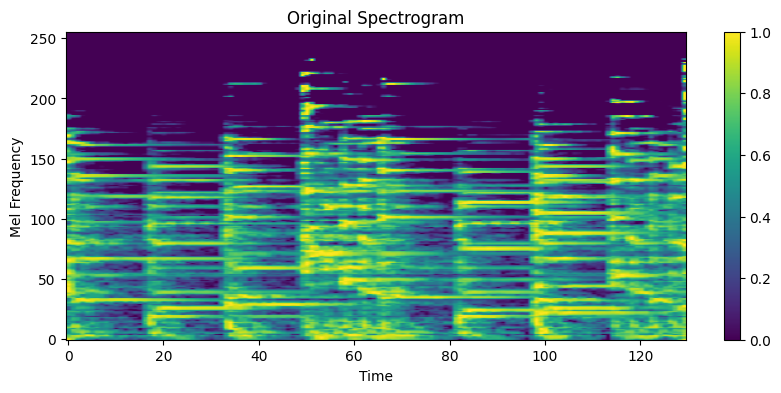

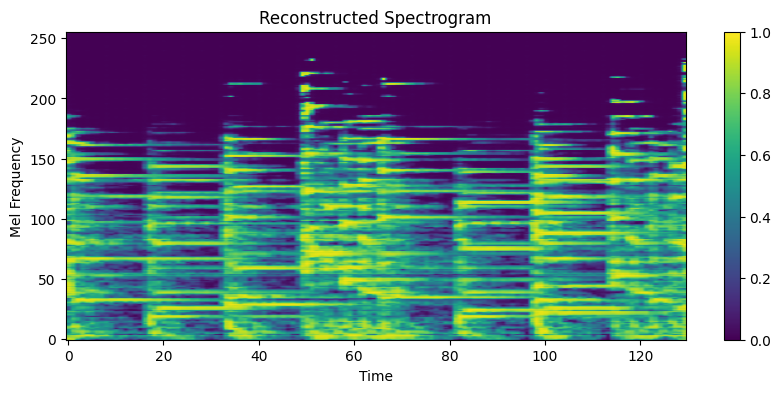

Training:  71%|███████   | 71/100 [10:47<04:25,  9.14s/epoch]

Epoch 70/100, Loss: 13.7714, Lr: 0.0001


Training:  72%|███████▏  | 72/100 [10:56<04:15,  9.12s/epoch]

Epoch 71/100, Loss: 13.7565, Lr: 0.0001


Training:  73%|███████▎  | 73/100 [11:05<04:04,  9.06s/epoch]

Epoch 72/100, Loss: 13.5184, Lr: 0.0001


Training:  74%|███████▍  | 74/100 [11:14<03:56,  9.10s/epoch]

Epoch 73/100, Loss: 13.2288, Lr: 0.0001


Training:  75%|███████▌  | 75/100 [11:23<03:47,  9.11s/epoch]

Epoch 74/100, Loss: 13.4041, Lr: 0.0001


Training:  76%|███████▌  | 76/100 [11:33<03:39,  9.13s/epoch]

Epoch 75/100, Loss: 13.2833, Lr: 0.0001


Training:  77%|███████▋  | 77/100 [11:42<03:29,  9.12s/epoch]

Epoch 76/100, Loss: 13.0615, Lr: 0.0001


Training:  78%|███████▊  | 78/100 [11:51<03:21,  9.14s/epoch]

Epoch 77/100, Loss: 13.1865, Lr: 0.0001


Training:  79%|███████▉  | 79/100 [12:00<03:12,  9.14s/epoch]

Epoch 78/100, Loss: 12.7650, Lr: 0.0001
Epoch 79/100, Loss: 13.0100, Lr: 0.0001


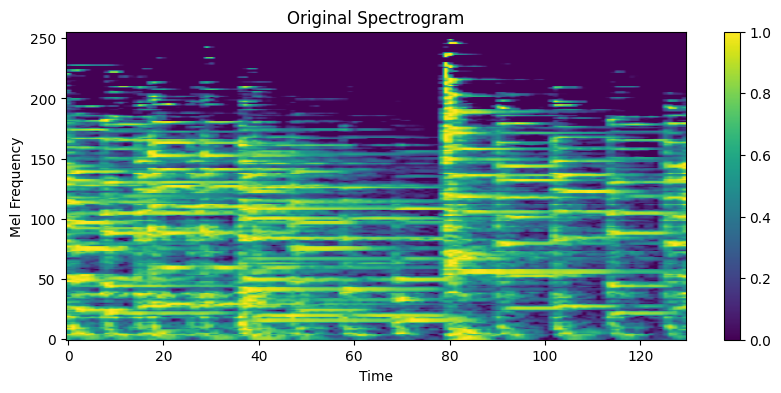

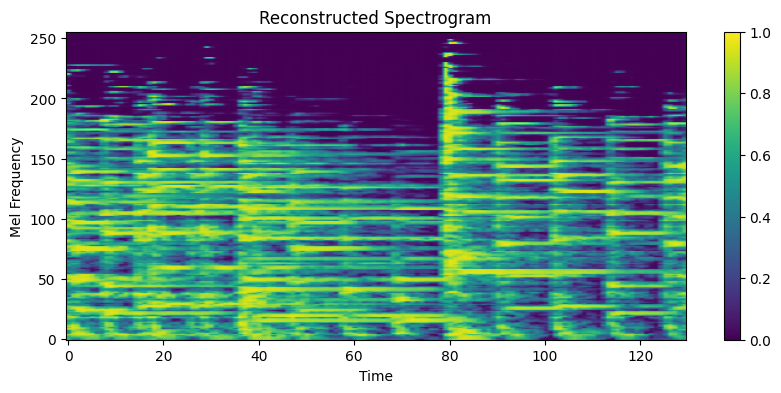

Training:  81%|████████  | 81/100 [12:19<02:54,  9.19s/epoch]

Epoch 80/100, Loss: 12.8848, Lr: 0.0001


Training:  82%|████████▏ | 82/100 [12:27<02:43,  9.11s/epoch]

Epoch 81/100, Loss: 12.5007, Lr: 0.0001


Training:  83%|████████▎ | 83/100 [12:36<02:33,  9.05s/epoch]

Epoch 82/100, Loss: 12.7198, Lr: 0.0001


Training:  84%|████████▍ | 84/100 [12:45<02:24,  9.04s/epoch]

Epoch 83/100, Loss: 12.0421, Lr: 0.0001


Training:  85%|████████▌ | 85/100 [12:54<02:15,  9.05s/epoch]

Epoch 84/100, Loss: 11.9910, Lr: 0.0001


Training:  86%|████████▌ | 86/100 [13:04<02:07,  9.07s/epoch]

Epoch 85/100, Loss: 12.0248, Lr: 0.0001


Training:  87%|████████▋ | 87/100 [13:13<01:58,  9.13s/epoch]

Epoch 86/100, Loss: 11.7444, Lr: 0.0001


Training:  88%|████████▊ | 88/100 [13:22<01:49,  9.10s/epoch]

Epoch 87/100, Loss: 12.0338, Lr: 0.0001


Training:  89%|████████▉ | 89/100 [13:31<01:39,  9.05s/epoch]

Epoch 88/100, Loss: 11.9966, Lr: 0.0001
Epoch 89/100, Loss: 11.7061, Lr: 0.0001


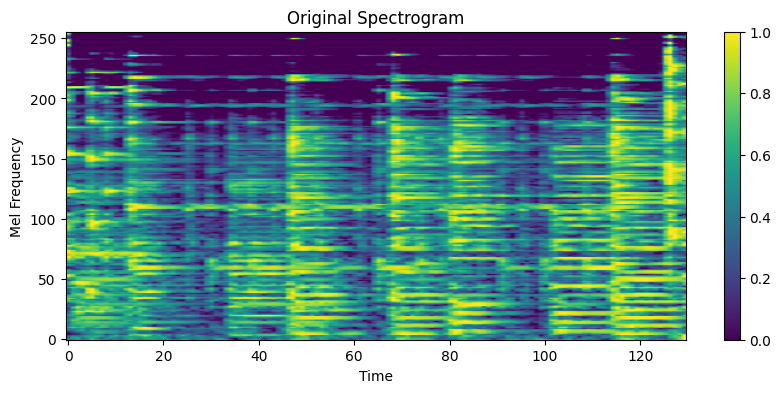

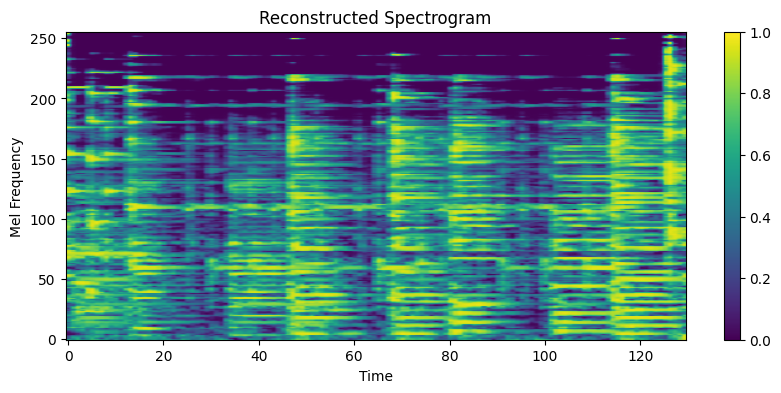

Training:  91%|█████████ | 91/100 [13:49<01:22,  9.13s/epoch]

Epoch 90/100, Loss: 11.4824, Lr: 0.0001


Training:  92%|█████████▏| 92/100 [13:58<01:12,  9.05s/epoch]

Epoch 91/100, Loss: 11.5552, Lr: 0.0001


Training:  93%|█████████▎| 93/100 [14:07<01:03,  9.02s/epoch]

Epoch 92/100, Loss: 11.4063, Lr: 0.0001


Training:  94%|█████████▍| 94/100 [14:16<00:54,  9.02s/epoch]

Epoch 93/100, Loss: 11.4605, Lr: 0.0001


Training:  95%|█████████▌| 95/100 [14:25<00:44,  8.98s/epoch]

Epoch 94/100, Loss: 10.9349, Lr: 0.0001


Training:  96%|█████████▌| 96/100 [14:34<00:35,  8.97s/epoch]

Epoch 95/100, Loss: 11.2493, Lr: 0.0001


Training:  97%|█████████▋| 97/100 [14:43<00:26,  8.96s/epoch]

Epoch 96/100, Loss: 11.3038, Lr: 0.0001


Training:  98%|█████████▊| 98/100 [14:52<00:18,  9.01s/epoch]

Epoch 97/100, Loss: 10.7143, Lr: 0.0001


Training:  99%|█████████▉| 99/100 [15:01<00:08,  8.99s/epoch]

Epoch 98/100, Loss: 11.0992, Lr: 0.0001
Epoch 99/100, Loss: 10.6387, Lr: 5e-05


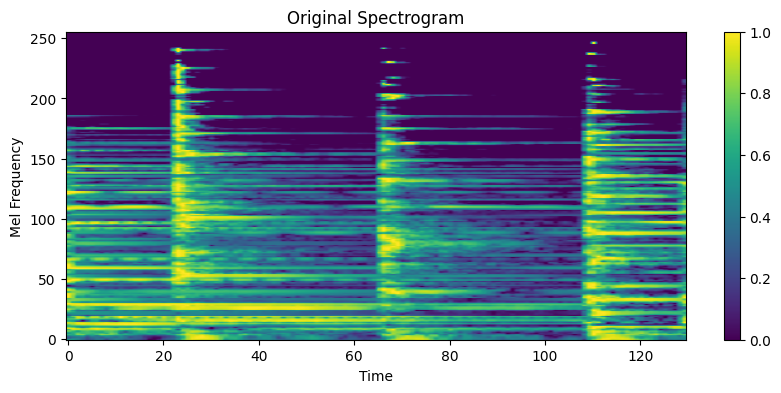

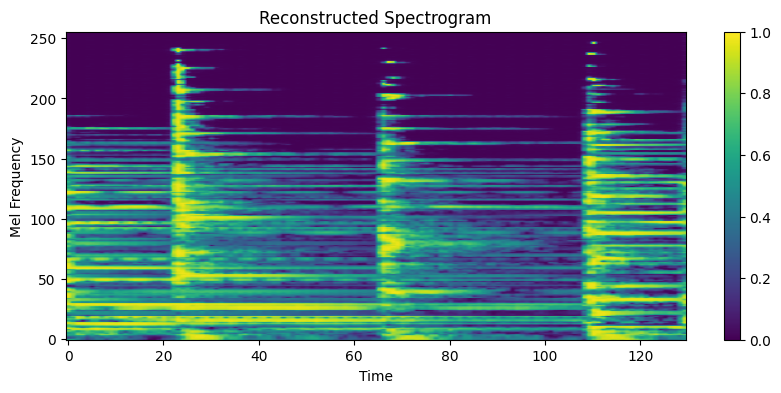

Training: 100%|██████████| 100/100 [15:10<00:00,  9.11s/epoch]


In [ ]:
d_model = 64
latent_dim = 128
lr = 2e-4
num_epochs = 100
step_size = num_epochs//2
verbose_interval = num_epochs//10
gamma = 0.5

model = CVAE(d_model, latent_dim, n_mels, frame, max_genres).to(device)
optimizer = optim.AdamW(model.parameters(), lr=lr)
scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=step_size, gamma=gamma)

print(f"Total number of parameters: {sum(p.numel() for p in model.parameters())}")
mu, logvar, losses = train_vae(model, trainloader, optimizer, scheduler, num_epochs, verbose_interval=verbose_interval)

In [ ]:
torch.save(model.state_dict(), "model_checkpoint123.pth")

model = CVAE(d_model, latent_dim, n_mels, frame, max_genres).to(device)
model.load_state_dict(torch.load("model_checkpoint123.pth"))
model.eval()

32 17


CVAE(
  (encoder): Sequential(
    (0): Conv2d(26, 64, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): SiLU()
    (3): Dropout2d(p=0.05, inplace=False)
    (4): Conv2d(64, 128, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (5): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (6): SiLU()
    (7): Dropout2d(p=0.1, inplace=False)
    (8): Conv2d(128, 256, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (9): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): SiLU()
    (11): Dropout2d(p=0.15, inplace=False)
    (12): AdaptiveAvgPool2d(output_size=(1, 1))
    (13): Flatten(start_dim=1, end_dim=-1)
  )
  (fc_mu): Linear(in_features=256, out_features=128, bias=True)
  (fc_logvar): Linear(in_features=256, out_features=128, bias=True)
  (decoder_input): Linear(in_features=153, out_features=139264, bias=T

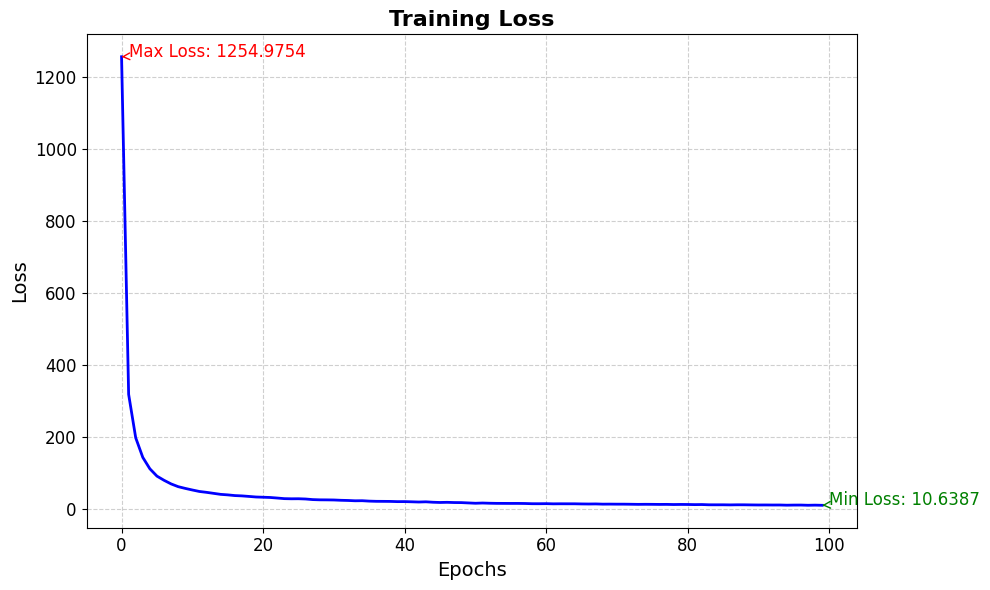

In [ ]:
def plot_losses(losses, title="Training Loss", xlabel="Epochs", ylabel="Loss", color='b', grid=True):
    plt.figure(figsize=(10, 6))
    plt.plot(losses, color=color, linewidth=2)
    plt.title(title, fontsize=16, fontweight="bold")
    plt.xlabel(xlabel, fontsize=14)
    plt.ylabel(ylabel, fontsize=14)
    plt.xticks(fontsize=12)
    plt.yticks(fontsize=12)
    plt.grid(grid, linestyle="--", alpha=0.6)

    min_loss_idx = losses.index(min(losses))
    max_loss_idx = losses.index(max(losses))

    plt.annotate(f"Min Loss: {min(losses):.4f}",
                 xy=(min_loss_idx, min(losses)),
                 xytext=(min_loss_idx + 1, min(losses) + 0.1),
                 arrowprops=dict(arrowstyle="->", color="green"),
                 fontsize=12, color='green')

    plt.annotate(f"Max Loss: {max(losses):.4f}",
                 xy=(max_loss_idx, max(losses)),
                 xytext=(max_loss_idx + 1, max(losses) + 0.1),
                 arrowprops=dict(arrowstyle="->", color="red"),
                 fontsize=12, color="red")

    plt.tight_layout()
    plt.show()

plot_losses(losses)


# 7. Inference

In [ ]:
def inference(model, testloader):
    model.eval()
    with torch.no_grad():
        data, genres_input, ori_data = next(iter(testloader))
        data = data.to(device)
        genres_input = genres_input.to(device)
        recon, _, _ = model(data, genres_input)
        return recon, genres_input, ori_data

In [ ]:
num_samples = 2

gen_mels, genres_input, ori_data = inference(model, trainloader)
recon_audios = []
recon_ori_audios = []

for i in range(len(gen_mels[:num_samples])):
    ori_reconstructed = melspec_to_audio(ori_data[i].cpu().numpy().squeeze(), sample_rate)
    recon_ori_audios.append(ori_reconstructed)

    spec_denorm = denormalize_melspec(gen_mels[i].cpu().numpy().squeeze(), ori_data[i].cpu().numpy().squeeze())
    audio_reconstructed = melspec_to_audio(spec_denorm, sample_rate)
    recon_audios.append(audio_reconstructed)

    display_audio_files(audio_reconstructed, sample_rate, original_audio=ori_reconstructed)
    print("-"*100, end="\n\n")

recon_ori_audios = np.concatenate(recon_ori_audios)
display_audio_files(recon_ori_audios, sample_rate, title="Connect all original audio")
recon_audios = np.concatenate(recon_audios)
display_audio_files(recon_audios, sample_rate, title="Connect all reconstructed audio")

Original Audio:


Reconstructed Audio (from Mel Spectrogram):


----------------------------------------------------------------------------------------------------

Original Audio:


Reconstructed Audio (from Mel Spectrogram):


----------------------------------------------------------------------------------------------------

Connect all original audio


Connect all reconstructed audio


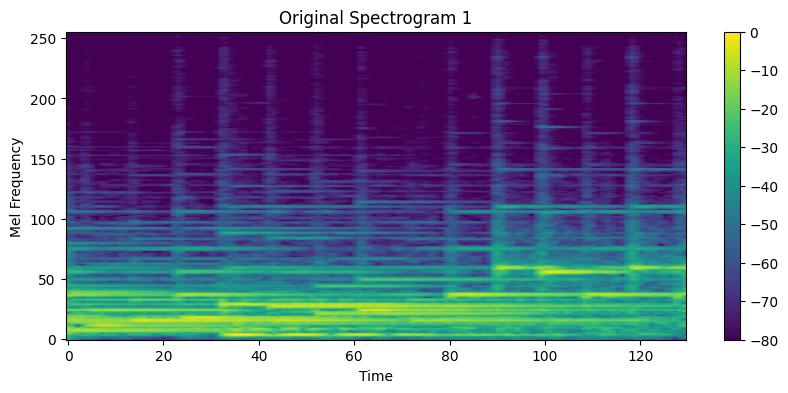

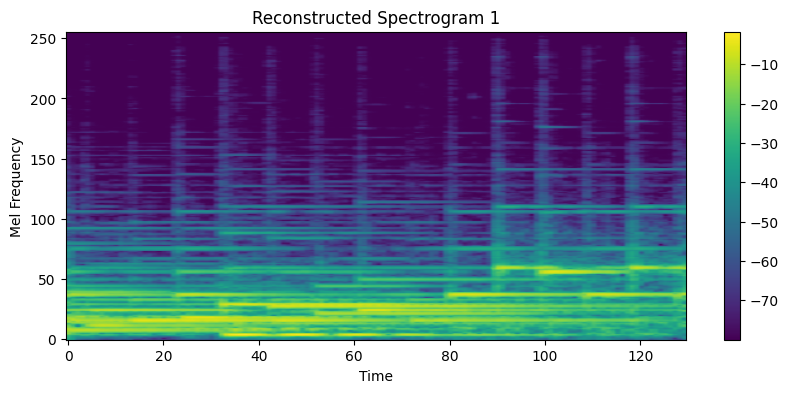

Original Audio:


Reconstructed Audio (from Mel Spectrogram):


----------------------------------------------------------------------------------------------------



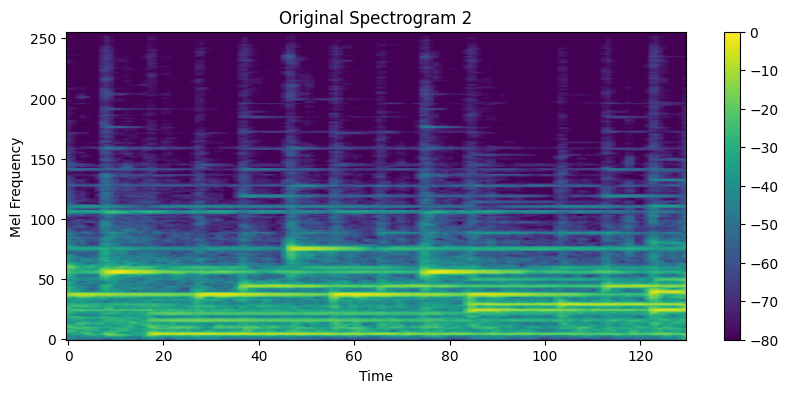

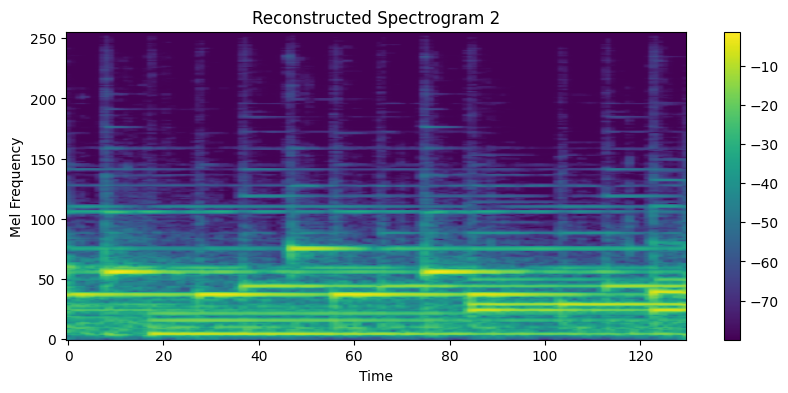

Original Audio:


Reconstructed Audio (from Mel Spectrogram):


----------------------------------------------------------------------------------------------------

Connect all original audio


Connect all reconstructed audio


In [ ]:
gen_mels, genres_input, ori_data = inference(model, testloader)
recon_audios = []
ori_audios = []

for i in range(len(gen_mels[:num_samples])):
    show_spectrogram(ori_data[i], title=f"Original Spectrogram {i+1}", denormalize=True)
    ori_reconstructed = melspec_to_audio(ori_data[i].cpu().numpy().squeeze(), sample_rate)
    ori_audios.append(ori_reconstructed)

    spec_denorm = denormalize_melspec(gen_mels[i].cpu().numpy().squeeze(), ori_data[i].cpu().numpy().squeeze())
    show_spectrogram(spec_denorm, title=f"Reconstructed Spectrogram {i+1}", denormalize=True, is_numpy=True)
    audio_reconstructed = melspec_to_audio(spec_denorm, sample_rate)
    recon_audios.append(audio_reconstructed)

    display_audio_files(audio_reconstructed, sample_rate, original_audio=ori_reconstructed)
    print("-"*100, end="\n\n")

ori_audios = np.concatenate(ori_audios)
display_audio_files(ori_audios, sample_rate, title="Connect all original audio")
recon_audios = np.concatenate(recon_audios)
display_audio_files(recon_audios, sample_rate, title="Connect all reconstructed audio")

# 8. Inference (generative)

In [ ]:
def generate(model, dataloader, genres_list, num_samples=5, diff_level=1):
    model.eval()
    with torch.no_grad():
        data, old_genres_input, ori_data = next(iter(dataloader))
        data = data.to(device)

        genres_tokens = tokenize(genres_list)
        genres_input = onehot_encode(genres_tokens, model.n_genres)
        genres_input = torch.tensor(genres_input, dtype=torch.long).unsqueeze(0)
        genres_input = genres_input.repeat(old_genres_input.shape[0], 1)
        genres_input = genres_input.to(device)

        recon, mu, logvar = model(data, genres_input)
        ori_audios = []
        recon_audios = []
        for i in range(num_samples):
            old_genres_list = detokenize_tolist(onehot_decode(old_genres_input[i].squeeze().tolist()))
            show_spectrogram(data[i], title="Original Spectrogram with Genres: " + ", ".join(old_genres_list))
            show_spectrogram(recon[i], title="Reconstructed Spectrogram with Genres: " + ", ".join(genres_list))

            diff_spectrogram = torch.abs(data[i] - recon[i]) * diff_level
            show_spectrogram(diff_spectrogram, title=f"Difference Spectrogram (|Original - Reconstructed|) * {diff_level}")
            print("Loss: ", loss_function(recon[i], data[i], mu, logvar).item())

            spec_denorm = denormalize_melspec(recon[i].cpu().numpy().squeeze(), ori_data[i].cpu().numpy().squeeze())
            audio_reconstructed = melspec_to_audio(spec_denorm, sr=sample_rate)
            ori_audio = melspec_to_audio(ori_data[i].cpu().numpy().squeeze(), sr=sample_rate)

            recon_audios.append(audio_reconstructed)
            ori_audios.append(ori_audio)

            display_audio_files(ori_audio, sample_rate, title="Reconstructed Audio with Genres: " + ", ".join(old_genres_list))
            display_audio_files(audio_reconstructed, sample_rate, title="Reconstructed Audio with Genres: " + ", ".join(genres_list))

        if num_samples > 1:
            print("-"*100, "Connect all audio", "-"*100)
            recon_ori_audios = np.concatenate(ori_audios)
            display_audio_files(recon_ori_audios, sample_rate, title="Connect all original audio")
            recon_audios = np.concatenate(recon_audios)
            display_audio_files(recon_audios, sample_rate, title="Connect all reconstructed audio")

In [ ]:
print(unique_genres)

{'New Age', 'House', 'Ambient', 'Christmas', 'Classical', 'Composed Music', 'Chill-out', 'Dance', 'Jazz', 'Lounge', 'Contemporary Classical', 'Blues', 'Ambient Electronic', 'Pop', 'Instrumental', '20th Century Classical', 'Soundtrack', 'Lo-fi Instrumental', 'Indie-Rock', 'Halloween', 'Electronic', 'Easy Listening', 'Piano', 'Lo-fi Electronic', 'Drone'}


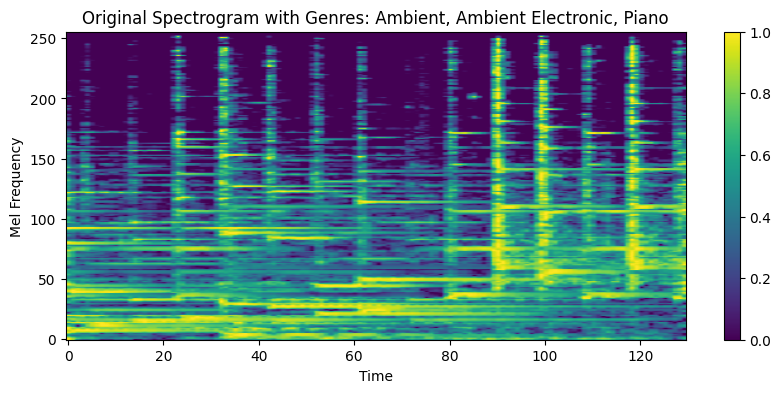

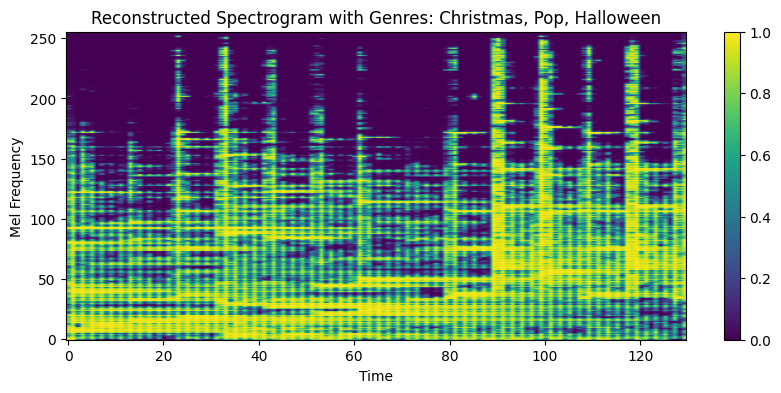

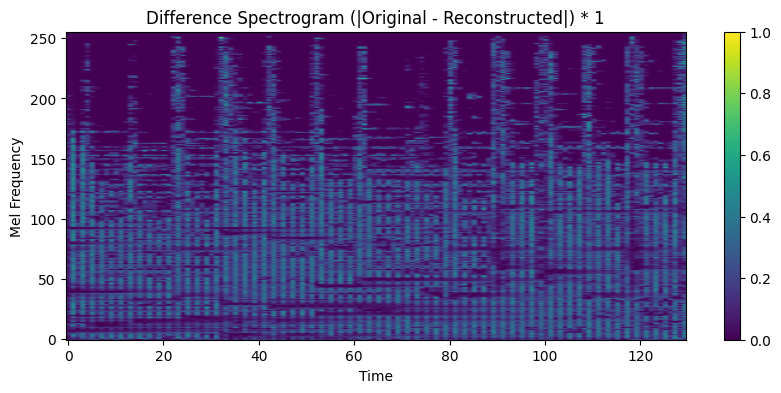

Loss:  1148.8287353515625
Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Christmas, Pop, Halloween


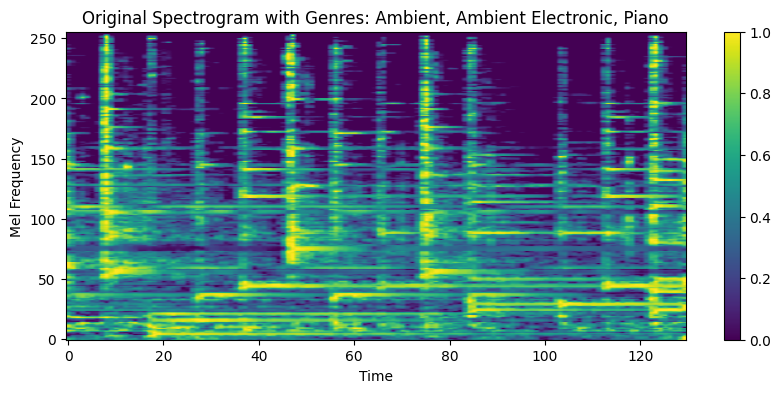

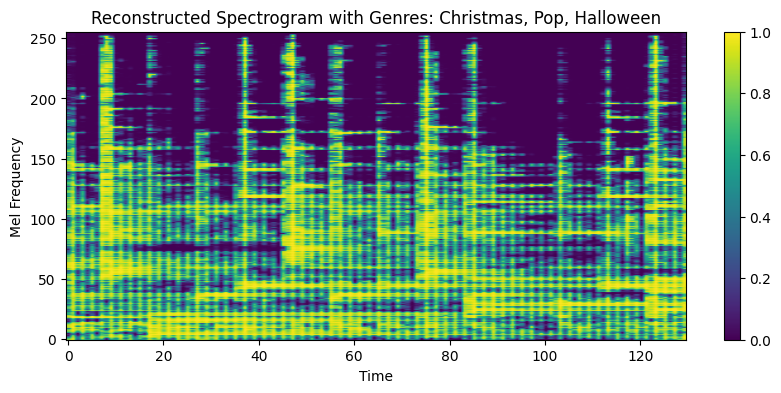

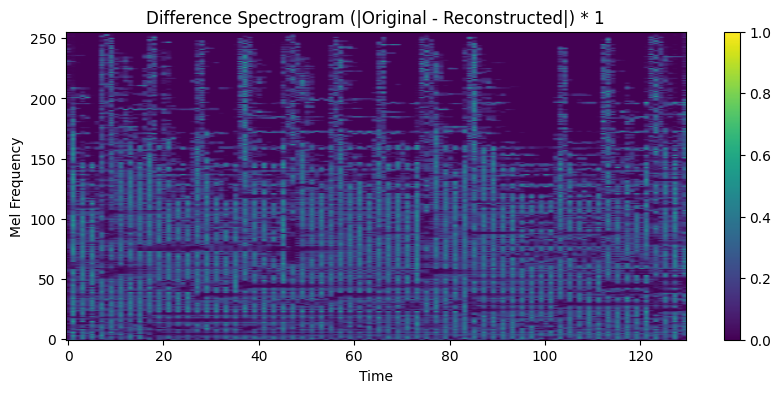

Loss:  1248.2479248046875
Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Christmas, Pop, Halloween


---------------------------------------------------------------------------------------------------- Connect all audio ----------------------------------------------------------------------------------------------------
Connect all original audio


Connect all reconstructed audio


In [ ]:
new_genres = ["Christmas", "Pop", "Halloween"]
generate(model, testloader, new_genres, num_samples=2)


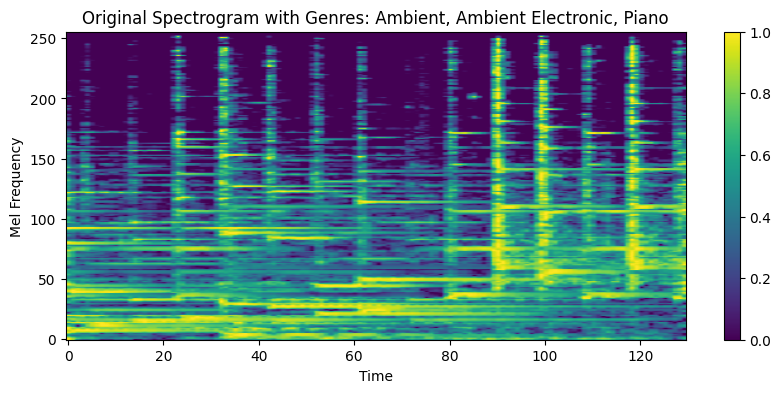

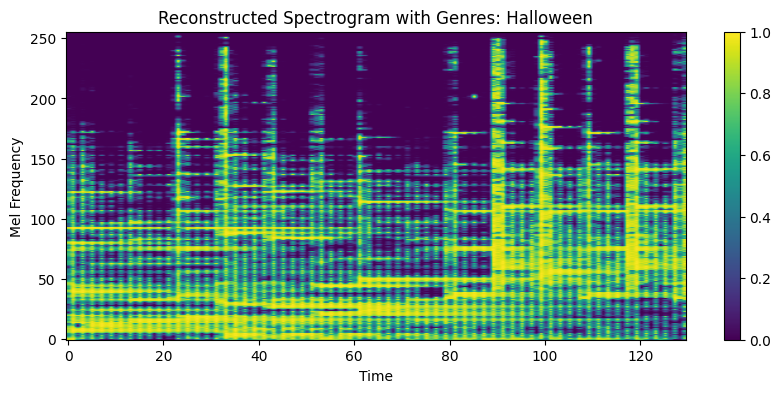

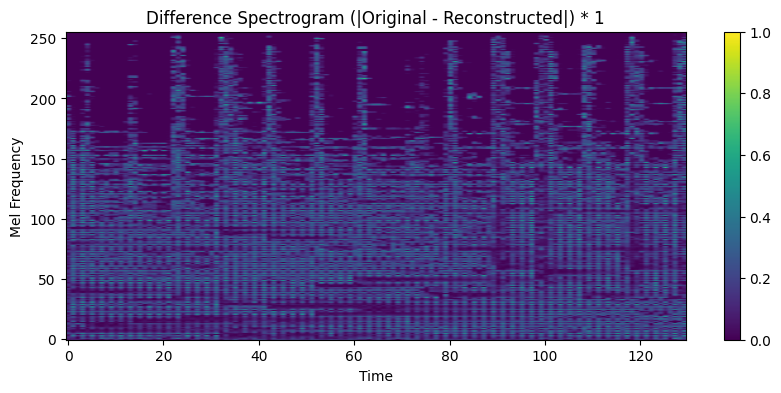

Loss:  941.1688842773438
Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Halloween


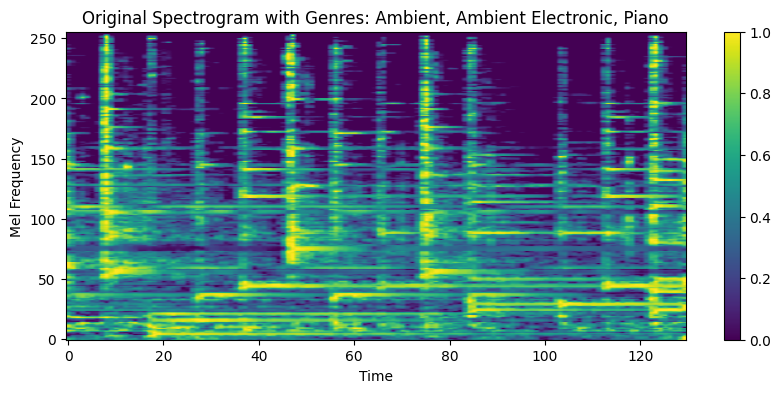

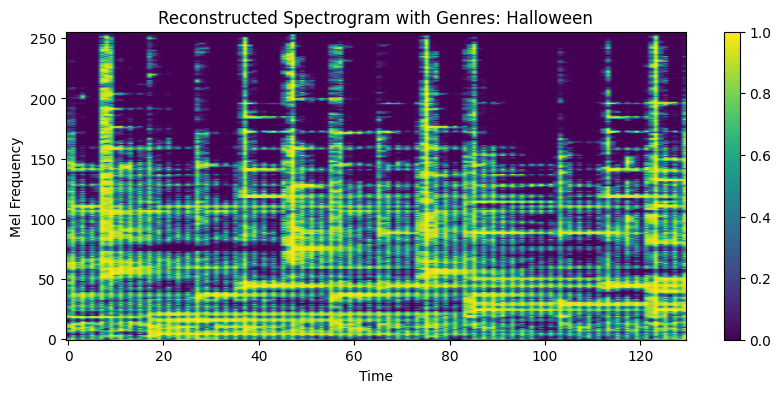

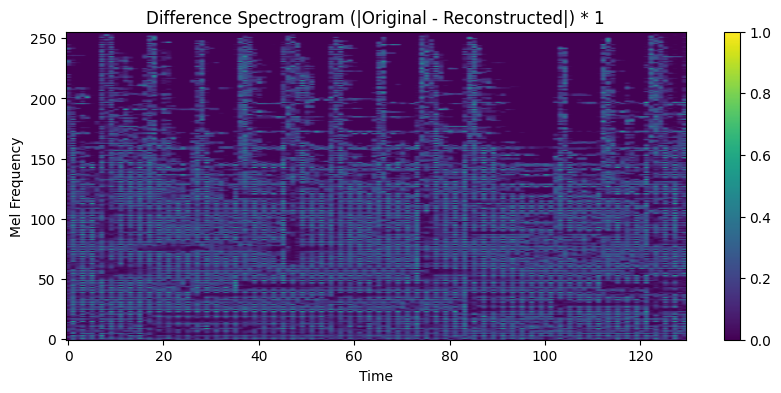

Loss:  1046.7791748046875


Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Halloween


---------------------------------------------------------------------------------------------------- Connect all audio ----------------------------------------------------------------------------------------------------
Connect all original audio


Connect all reconstructed audio


In [ ]:
new_genres = ["Halloween"]
generate(model, testloader, new_genres, num_samples=2)

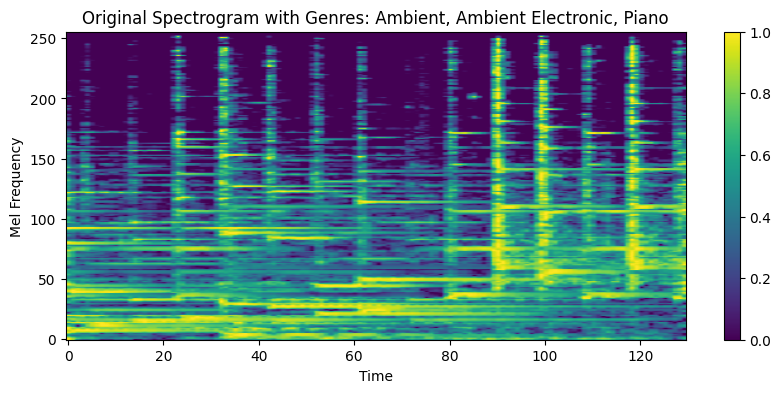

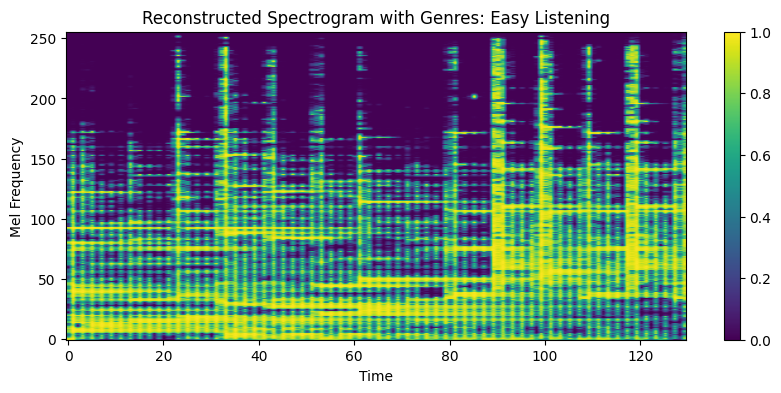

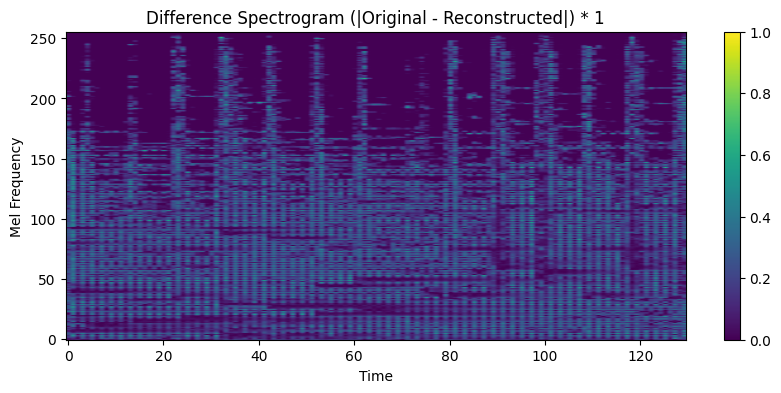

Loss:  1042.69677734375
Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Easy Listening


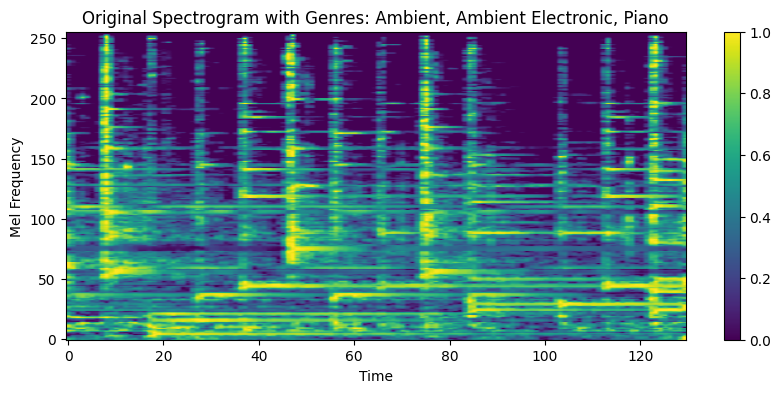

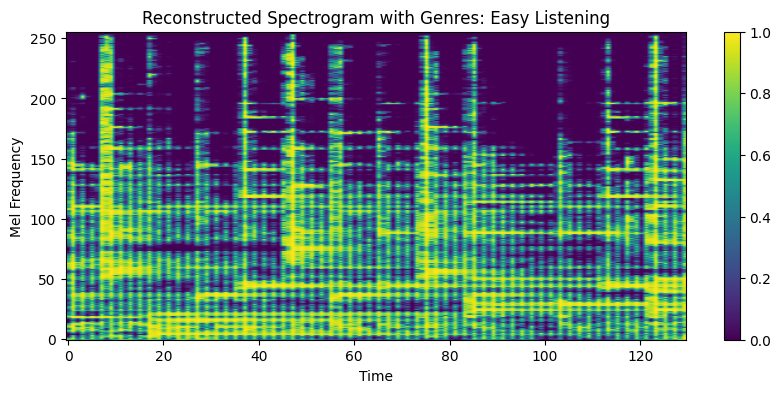

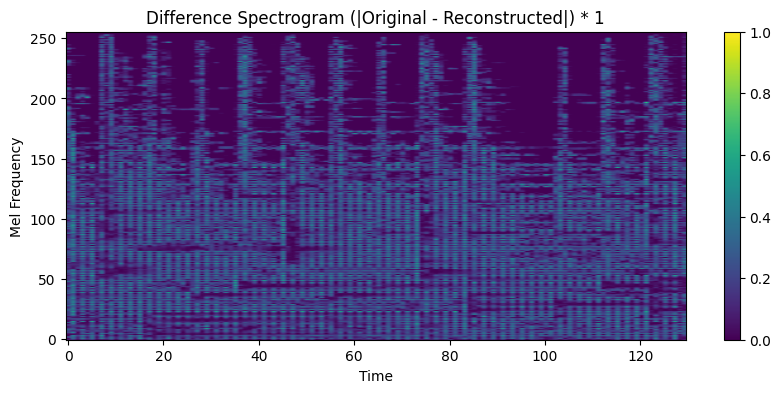

Loss:  1143.2694091796875
Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Easy Listening


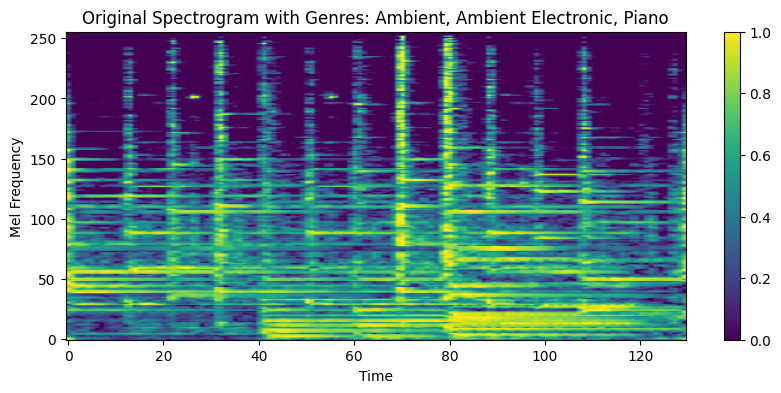

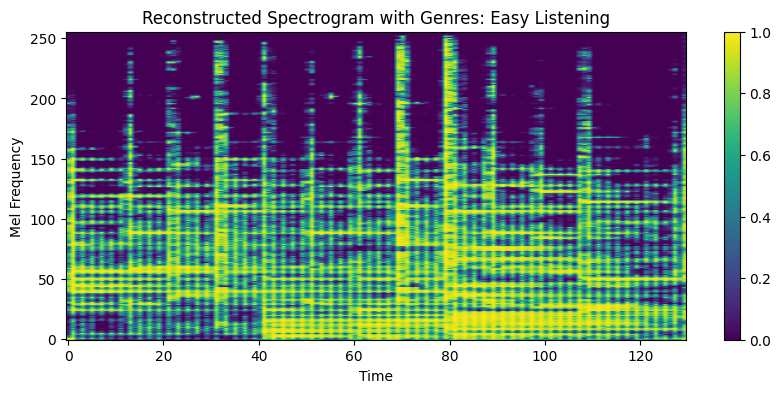

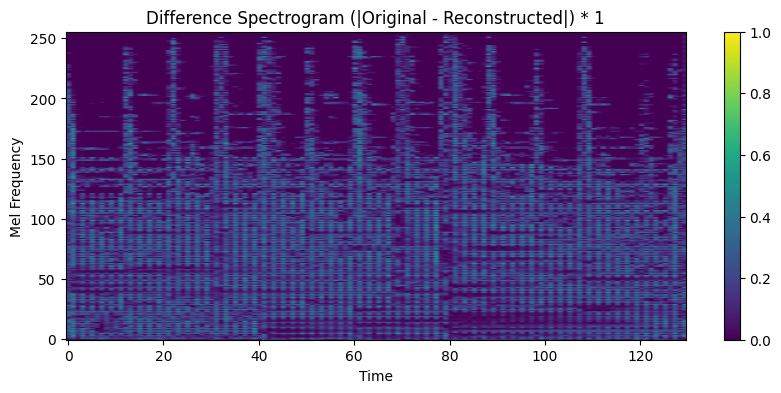

Loss:  994.2183837890625
Reconstructed Audio with Genres: Ambient, Ambient Electronic, Piano


Reconstructed Audio with Genres: Easy Listening


---------------------------------------------------------------------------------------------------- Connect all audio ----------------------------------------------------------------------------------------------------
Connect all original audio


Connect all reconstructed audio


In [ ]:
new_genres = ["Easy Listening"]

generate(model, testloader, new_genres, num_samples=3)